In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings 
from google.colab import drive
warnings.filterwarnings("ignore")
drive.mount('/content/drive', force_remount = True)

Mounted at /content/drive


In [ ]:
info_path = pd.read_csv('/content/drive/MyDrive/Measurement_info.csv')
stations_path = pd.read_csv('/content/drive/MyDrive/Measurement_station_info.csv')
items_path =pd.read_csv('/content/drive/MyDrive/Measurement_item_info.csv')
df_path = pd.read_csv('/content/drive/MyDrive/Measurement_summary.csv')
# Load the dataset

In [ ]:
print('Shape:', items_path.shape)
items_path

Shape: (6, 7)


,Item code,Item name,Unit of measurement,Good(Blue),Normal(Green),Bad(Yellow),Very bad(Red)
0,1,SO2,ppm,0.02,0.05,0.15,1.0
1,3,NO2,ppm,0.03,0.06,0.20,2.0
2,5,CO,ppm,2.00,9.00,15.00,50.0
3,6,O3,ppm,0.03,0.09,0.15,0.5
4,8,PM10,Mircrogram/m3,30.00,80.00,150.00,600.0
5,9,PM2.5,Mircrogram/m3,15.00,35.00,75.00,500.0


In [ ]:
df_path['Station code'].unique()

array([101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113,
       114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125])

In [ ]:
df_path

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.059,0.002,1.2,73.0,57.0
1,2017-01-01 01:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.058,0.002,1.2,71.0,59.0
2,2017-01-01 02:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,59.0
3,2017-01-01 03:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,58.0
4,2017-01-01 04:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.051,0.002,1.2,69.0,61.0
...,...,...,...,...,...,...,...,...,...,...,...
647506,2019-12-31 19:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.028,0.013,0.5,23.0,17.0
647507,2019-12-31 20:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.025,0.015,0.4,25.0,19.0
647508,2019-12-31 21:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.023,0.015,0.4,24.0,17.0
647509,2019-12-31 22:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.040,0.004,0.5,25.0,18.0


In [ ]:
df_path['Measurement date'] = pd.to_datetime(df_path['Measurement date'])

In [ ]:
# AQI
polluents = {'SO2':[0.02,0.05,0.15,1],'NO2':[0.03,0.06,0.2,2],'CO':[2,9,15,50],'O3':[0.03,0.09,0.15,0.5],'PM2.5':[15,35,75,500],'PM10':[30,80,150,600]}
quality = ['Good','Normal','Bad','Very Bad']
seoul_standard = pd.DataFrame(polluents, index=quality)
seoul_standard

,SO2,NO2,CO,O3,PM2.5,PM10
Good,0.02,0.03,2,0.03,15,30
Normal,0.05,0.06,9,0.09,35,80
Bad,0.15,0.20,15,0.15,75,150
Very Bad,1.00,2.00,50,0.50,500,600


In [ ]:
df_path_101 = pd.DataFrame(df_path.loc[(df_path['Station code']==101)])

In [ ]:
df_path_101.head()

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.059,0.002,1.2,73.0,57.0
1,2017-01-01 01:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.058,0.002,1.2,71.0,59.0
2,2017-01-01 02:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,59.0
3,2017-01-01 03:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.004,0.056,0.002,1.2,70.0,58.0
4,2017-01-01 04:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.051,0.002,1.2,69.0,61.0


In [ ]:
df_path_101.drop("Station code", axis=1, inplace=True)

In [ ]:
import plotly
import plotly.graph_objs as go
import plotly.offline as py

In [ ]:
plotly.offline.init_notebook_mode(connected=True)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['SO2'])]

In [ ]:
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})

In [ ]:
fig = go.Figure(data=data, layout=layout)

In [ ]:
py.iplot(fig)

In [ ]:
print("We have", df_path_101['SO2'].loc[(df_path_101['SO2']<0)].count(),"negative values for SO2")
print("We have", df_path_101['NO2'].loc[(df_path_101['NO2']<0)].count(),"negative values for NO2")
print("We have", df_path_101['O3'].loc[(df_path_101['O3']<0)].count(),"negative values for O3")
print("We have", df_path_101['CO'].loc[(df_path_101['CO']<0)].count(),"negative values for CO")
print("We have", df_path_101['PM2.5'].loc[(df_path_101['PM2.5']<0)].count(),"negative values for PM2.5")
print("We have", df_path_101['PM10'].loc[(df_path_101['PM10']<0)].count(),"negative values for PM10")

We have 28 negative values for SO2
We have 28 negative values for NO2
We have 28 negative values for O3
We have 28 negative values for CO
We have 42 negative values for PM2.5
We have 30 negative values for PM10


In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['SO2'], name='SO2'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['NO2'], name='NO2'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['CO'], name='CO'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['O3'], name='O3')]
       
##layout object
layout = go.Layout(title='Gases Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
py.iplot(fig)

In [ ]:
to_drop = df_path_101.loc[(df_path_101['SO2']<0) | (df_path_101['NO2']<0) | (df_path_101['CO']<0) | (df_path_101['O3']<0)]
to_drop

,Measurement date,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
854,2017-02-05 14:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
855,2017-02-05 15:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
856,2017-02-05 16:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
857,2017-02-05 17:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
858,2017-02-05 18:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
859,2017-02-05 19:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
860,2017-02-05 20:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
861,2017-02-05 21:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
862,2017-02-05 22:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
863,2017-02-05 23:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


In [ ]:
df_path_101.drop(to_drop.index, axis=0, inplace=True)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['SO2'], name='SO2'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['NO2'], name='NO2'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['CO'], name='CO'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['O3'], name='O3')]
       
##layout object
layout = go.Layout(title='Gases Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
py.iplot(fig)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['PM2.5'], name='PM2.5'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['PM10'], name='PM10'),
        ]
       
##layout object
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
py.iplot(fig)

In [ ]:
to_drop_PM = df_path_101.loc[(df_path_101['PM2.5']<0) | (df_path_101['PM10']<0) | (df_path_101['PM2.5']==0) | (df_path_101['PM10']==0)]
df_path_101.drop(to_drop_PM.index, axis=0, inplace=True)
to_drop_PM

,Measurement date,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
2247,2017-04-04 15:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.072,0.012,0.034,7.3,2.0,-1.0
3255,2017-05-16 15:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3467,2017-05-25 11:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3953,2017-06-14 17:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
4142,2017-06-22 14:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
24387,2019-10-29 06:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.002,0.032,0.002,0.6,1.0,0.0
24388,2019-10-29 07:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.039,0.002,0.8,0.0,0.0
24389,2019-10-29 08:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.040,0.004,0.8,1.0,0.0
24390,2019-10-29 09:00:00,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.003,0.026,0.014,0.5,0.0,0.0


In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['PM2.5'], name='PM2.5'),
        go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['PM10'], name='PM10'),
        ]
       
##layout object
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

## Plotting
py.iplot(fig)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['SO2'])]
       
##layout object
layout = go.Layout(title='SO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

    

##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-03-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.02,
            x1='2019-12-31 23:00:00',
            y1=0.02,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.05,
            x1='2019-12-31 23:00:00',
            y1=0.05,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
py.iplot(fig)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['NO2'])]
       
##layout object
layout = go.Layout(title='NO2 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

    

##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-03-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.03,
            x1='2019-12-31 23:00:00',
            y1=0.03,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.06,
            x1='2019-12-31 23:00:00',
            y1=0.06,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
py.iplot(fig)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['O3'])]
       
##layout object
layout = go.Layout(title='O3 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

    

##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-03-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.03,
            x1='2019-12-31 23:00:00',
            y1=0.03,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=0.09,
            x1='2019-12-31 23:00:00',
            y1=0.09,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
py.iplot(fig)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['PM2.5'])]
       
##layout object
layout = go.Layout(title='PM2.5 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

    

##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-03-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=15,
            x1='2019-12-31 23:00:00',
            y1=15,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=35,
            x1='2019-12-31 23:00:00',
            y1=35,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
py.iplot(fig)

In [ ]:
data = [go.Scatter(x=df_path_101['Measurement date'],
                   y=df_path_101['PM10'])]
       
##layout object
layout = go.Layout(title='PM10 Levels',
                    yaxis={'title':'Level (ppm)'},
                    xaxis={'title':'Date'})
                    
## Figure object

fig = go.Figure(data=data, layout=layout)

    

##Adding the text and positioning it
fig.add_trace(go.Scatter(
    x=['2017-03-01 00:00:00', '2017-07-31 23:00:00'],
    y=[0.2, 0.15],
    text=["Safe Level - Green", "Normal Level - Orange"],
    mode="text",
            ))

##Adding horizontal line
fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=30,
            x1='2019-12-31 23:00:00',
            y1=30,
            line=dict(
                color="Green",
                width=4,
                dash="dashdot",
            ))

fig.add_shape(
        # Line Horizontal
            type="line",
            x0='2017-01-01 00:00:00',
            y0=80,
            x1='2019-12-31 23:00:00',
            y1=80,
            line=dict(
                color="Orange",
                width=4,
                dash="dashdot",
            ))


## Plotting
py.iplot(fig)

KeyError: ignored

In [ ]:
to_drop_all = df_path.loc[(df_path_101['SO2']<0) | (df_path['NO2']<0) | (df_path['CO']<0) | (df_path['O3']<0)]
to_drop_PM_all = df_path.loc[(df_path_101['PM2.5']<0) | (df_path['PM10']<0) | (df_path['PM2.5']==0) | (df_path['PM10']==0)]
to_drop_all

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
854,2017-02-05 14:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
855,2017-02-05 15:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
856,2017-02-05 16:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
857,2017-02-05 17:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
858,2017-02-05 18:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
...,...,...,...,...,...,...,...,...,...,...,...
644864,2019-09-11 23:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
644865,2019-09-12 00:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
644866,2019-09-12 01:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
644867,2019-09-12 02:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


In [ ]:
to_drop_PM_all

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
3255,2017-05-16 15:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3467,2017-05-25 11:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
3953,2017-06-14 17:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
4142,2017-06-22 14:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.000,0.000,0.000,0.0,0.0,0.0
4480,2017-07-06 16:00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,0.005,0.037,0.127,0.6,0.0,-1.0
...,...,...,...,...,...,...,...,...,...,...,...
646470,2019-11-18 03:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.008,0.035,0.4,0.0,7.0
646471,2019-11-18 04:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.002,0.008,0.031,0.4,0.0,7.0
646472,2019-11-18 05:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.003,0.011,0.027,0.5,0.0,7.0
646473,2019-11-18 06:00:00,125,"59, Gucheonmyeon-ro 42-gil, Gangdong-gu, Seoul...",37.544962,127.136792,0.002,0.016,0.020,0.5,0.0,14.0


In [ ]:
drop_index = to_drop_all.index.append(to_drop_PM_all.index)
df_new = df_path.drop(drop_index, axis=0)

In [ ]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pylab
import matplotlib.pyplot as plt
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20, 16

import warnings
import itertools
warnings.filterwarnings("ignore")

In [ ]:
df_new['Measurement date'] = pd.datetime(df_new['Measurement date'],format='%Y-%m-%d')
df_new.set_index('Measurement date', drop=True, inplace=True)

TypeError: ignored

In [ ]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 636580 entries, 0 to 647510
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Measurement date  636580 non-null  datetime64[ns]
 1   Station code      636580 non-null  int64         
 2   Address           636580 non-null  object        
 3   Latitude          636580 non-null  float64       
 4   Longitude         636580 non-null  float64       
 5   SO2               636580 non-null  float64       
 6   NO2               636580 non-null  float64       
 7   O3                636580 non-null  float64       
 8   CO                636580 non-null  float64       
 9   PM10              636580 non-null  float64       
 10  PM2.5             636580 non-null  float64       
dtypes: datetime64[ns](1), float64(8), int64(1), object(1)
memory usage: 58.3+ MB


In [ ]:
df_new.dropna(inplace = True)

In [ ]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 636580 entries, 0 to 647510
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Measurement date  636580 non-null  datetime64[ns]
 1   Station code      636580 non-null  int64         
 2   Address           636580 non-null  object        
 3   Latitude          636580 non-null  float64       
 4   Longitude         636580 non-null  float64       
 5   SO2               636580 non-null  float64       
 6   NO2               636580 non-null  float64       
 7   O3                636580 non-null  float64       
 8   CO                636580 non-null  float64       
 9   PM10              636580 non-null  float64       
 10  PM2.5             636580 non-null  float64       
dtypes: datetime64[ns](1), float64(8), int64(1), object(1)
memory usage: 58.3+ MB


In [ ]:
df_path_101 = pd.DataFrame(df_new.loc[(df_new['Station code']==101)])
df_path_101 = df_path_101.set_index("Measurement date")
df_25 = df_path_101.iloc[:,-1:]   # Monthly total emissions (mte)
df_25

,PM2.5
Measurement date,
2017-01-01 00:00:00,57.0
2017-01-01 01:00:00,59.0
2017-01-01 02:00:00,59.0
2017-01-01 03:00:00,58.0
2017-01-01 04:00:00,61.0
...,...
2019-12-31 19:00:00,19.0
2019-12-31 20:00:00,19.0
2019-12-31 21:00:00,18.0


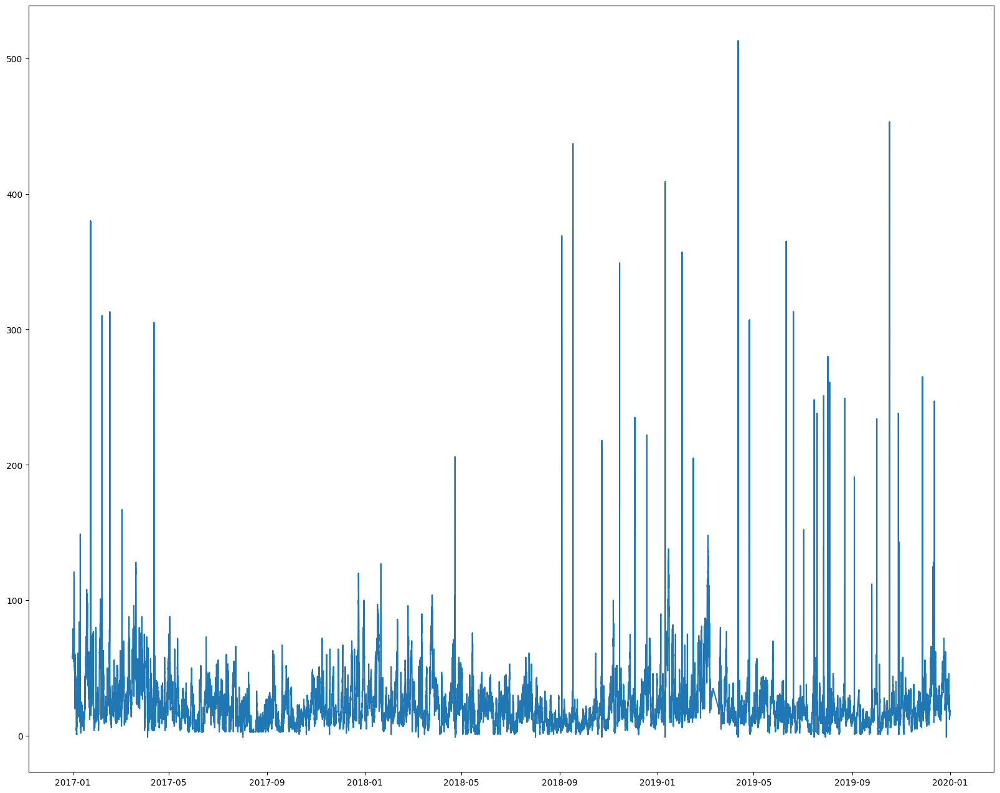

In [ ]:
import statsmodels
import statsmodels.api as sm
from statsmodels.tsa.stattools import coint, adfuller
plt.plot(df_25)

In [ ]:
def TestStationaryPlot(ts):
    rol_mean = ts.rolling(window = 12, center = False).mean()
    rol_std = ts.rolling(window = 12, center = False).std()
    
    plt.plot(ts, color = 'blue',label = 'Original Data')
    plt.plot(rol_mean, color = 'red', label = 'Rolling Mean')
    plt.plot(rol_std, color ='black', label = 'Rolling Std')
    plt.xticks(fontsize = 25)
    plt.yticks(fontsize = 25)
    
    plt.xlabel('Time in Years', fontsize = 25)
    plt.ylabel('Total Emissions', fontsize = 25)
    plt.legend(loc='best', fontsize = 25)
    plt.title('Rolling Mean & Standard Deviation', fontsize = 25)
    plt.show(block= True)

In [ ]:
def TestStationaryAdfuller(ts, cutoff = 0.01):
    ts_test = adfuller(ts, autolag = 'AIC')
    ts_test_output = pd.Series(ts_test[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    
    for key,value in ts_test[4].items():
        ts_test_output['Critical Value (%s)'%key] = value
    print(ts_test_output)
    
    if ts_test[1] <= cutoff:
        print("Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary")
    else:
        print("Weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

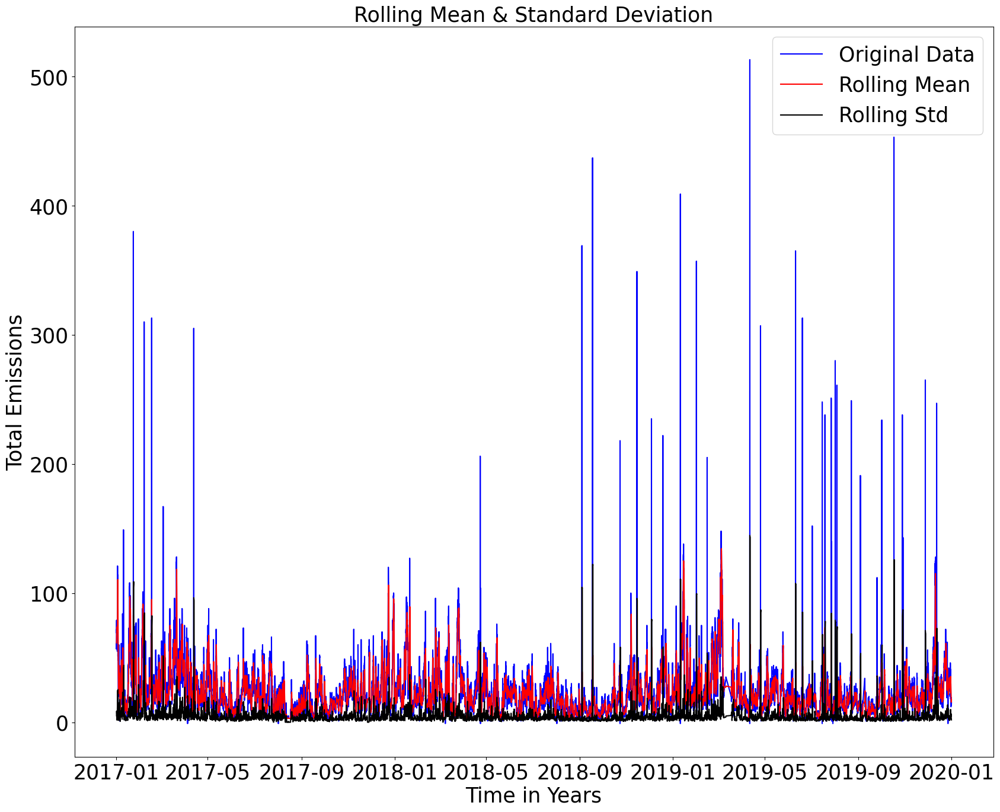

In [ ]:
TestStationaryPlot(df_25)

In [ ]:
TestStationaryAdfuller(df_25)

Test Statistic                -1.713771e+01
p-value                        7.079278e-30
#Lags Used                     1.900000e+01
Number of Observations Used    2.577600e+04
Critical Value (1%)           -3.430604e+00
Critical Value (5%)           -2.861652e+00
Critical Value (10%)          -2.566830e+00
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary


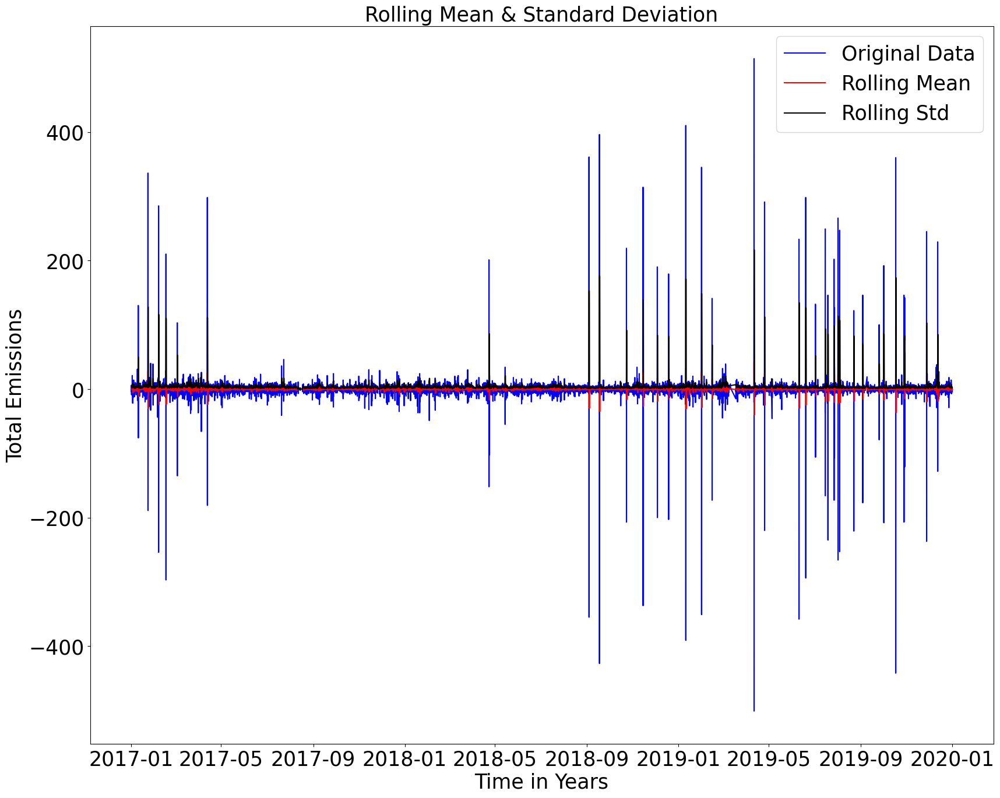

In [ ]:
mte_first_difference = df_25 - df_25.shift(1)  
TestStationaryPlot(mte_first_difference.dropna(inplace=False))

In [ ]:
TestStationaryAdfuller(mte_first_difference.dropna(inplace=False))

Test Statistic                   -31.513799
p-value                            0.000000
#Lags Used                        48.000000
Number of Observations Used    25746.000000
Critical Value (1%)               -3.430604
Critical Value (5%)               -2.861652
Critical Value (10%)              -2.566830
dtype: float64
Strong evidence against the null hypothesis, reject the null hypothesis. Data has no unit root, hence it is stationary


In [ ]:
TestStationaryAdfuller(mte_seasonal_first_difference.dropna(inplace=False))

NameError: ignored

NameError: ignored

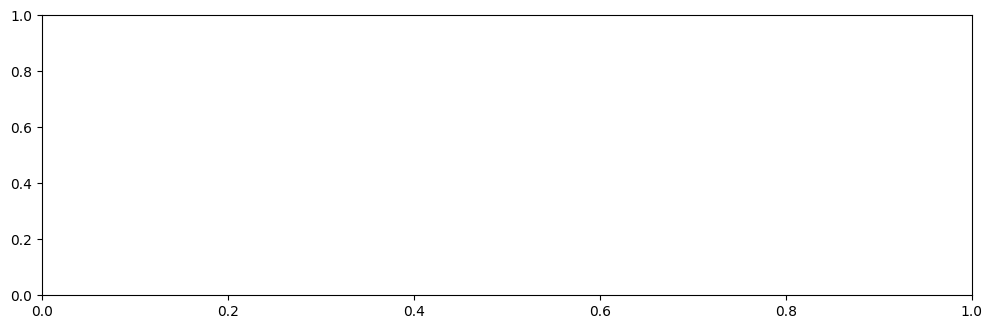

In [ ]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(mte_seasonal_first_difference.iloc[13:], lags=40, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(mte_seasonal_first_difference.iloc[13:], lags=40, ax=ax2)

In [ ]:
p = d = q = range(0, 2) # Define the p, d and q parameters to take any value between 0 and 2
pdq = list(itertools.product(p, d, q)) # Generate all different combinations of p, q and q triplets
pdq_x_QDQs = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))] # Generate all different combinations of seasonal p, q and q triplets
print('Examples of Seasonal ARIMA parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], pdq_x_QDQs[1]))
print('SARIMAX: {} x {}'.format(pdq[2], pdq_x_QDQs[2]))

Examples of Seasonal ARIMA parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 1, 0) x (0, 1, 0, 12)


In [ ]:
start_day = '2017-01-01'
end_day = '2019-12-31'
con1=df_25.index>=start_day
con2=df_25.index<=end_day
df_25_train=df_25[con1&con2]

In [ ]:
warnings.filterwarnings("ignore") # specify to ignore warning messages
for param in pdq:
    for param_seasonal in pdq_x_QDQs:
        try:
            mod = sm.tsa.statespace.SARIMAX(df_25_train,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False,
                                            enforce_invertibility=False)

            results = mod.fit()

            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:249183.36421274475
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:236870.49787729752
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:228012.69458152933
ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:221391.88207212085
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:224990.18637270408
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:221067.73415727337
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:223864.42146046282
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:219624.14557846083
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:231197.18523412303
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:224569.3563467291
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:222776.0596450987
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:213307.9445429243
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:218335.6264660858
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:213193.62841184184
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:217530.13767803146
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:212184.2168292465
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:210457.5198569497
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:210370.5752944018

In [ ]:
mod = sm.tsa.statespace.SARIMAX(df_25_train,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 1, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)

results = mod.fit()

print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2433      0.002    103.056      0.000       0.239       0.248
ma.L1         -0.7892      0.002   -360.334      0.000      -0.794      -0.785
ar.S.L12      -0.0087      0.005     -1.717      0.086      -0.019       0.001
ma.S.L12      -1.0011      0.001  -1953.834      0.000      -1.002      -1.000
sigma2       156.3455      0.173    902.873      0.000     156.006     156.685


<Axes: xlabel='Measurement date'>

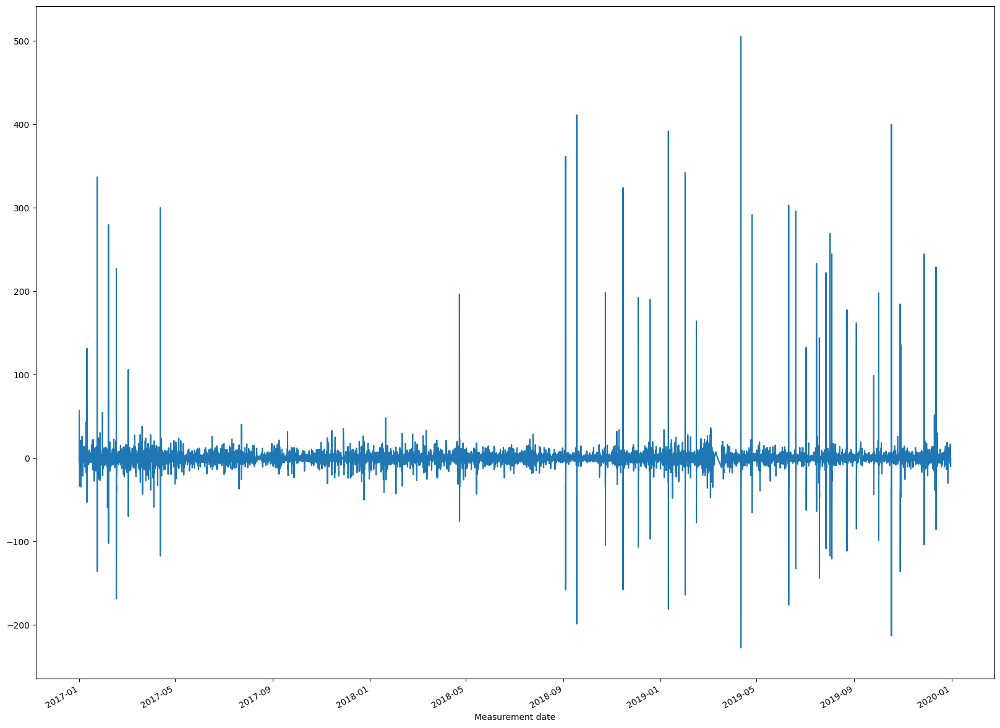

In [ ]:
results.resid.plot()

In [ ]:
print(results.resid.describe())

count    25773.000000
mean         0.026306
std         12.536952
min       -227.231503
25%         -2.437686
50%         -0.065333
75%          2.370695
max        505.209272
dtype: float64


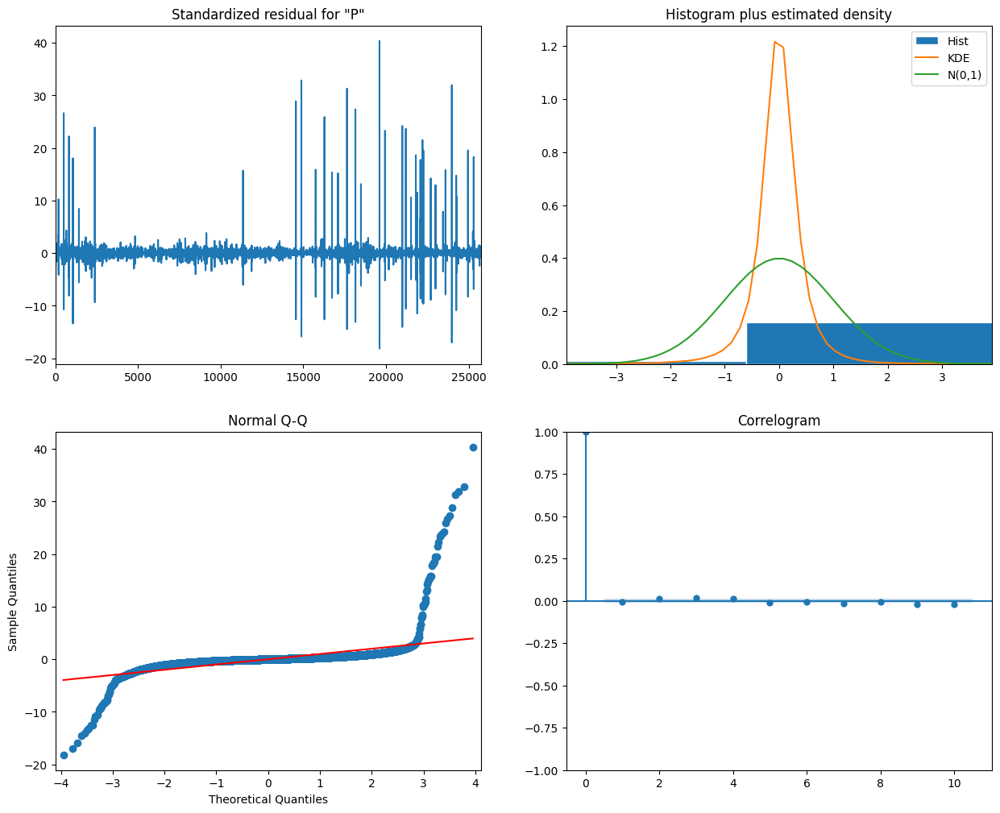

In [ ]:
results.plot_diagnostics(figsize=(15, 12))
plt.show()

In [ ]:
pred = results.get_prediction(start=pd.to_datetime('2019-12-01'), dynamic=False)
pred_ci = pred.conf_int()

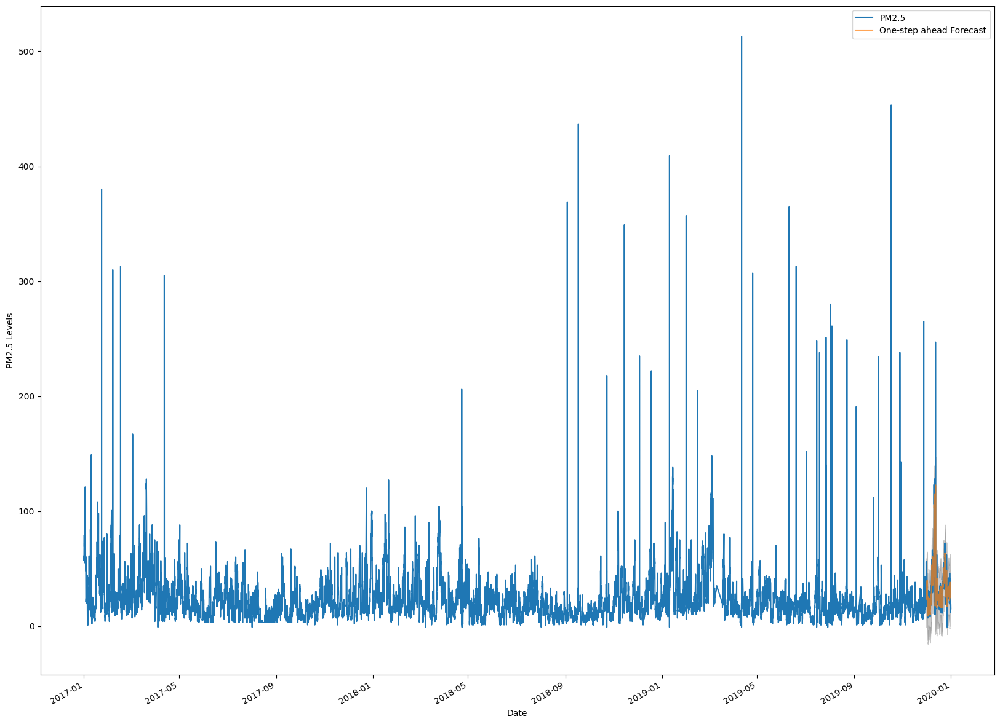

In [ ]:
ax = df_25['2017-01':].plot(label='observed')
pred.predicted_mean.plot(ax=ax, label='One-step ahead Forecast', alpha=.7)

ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)

ax.set_xlabel('Date')
ax.set_ylabel('PM2.5 Levels')
plt.legend()

plt.show()

In [ ]:
y_forecasted = pred.predicted_mean
y_forecasted = pd.DataFrame(y_forecasted,columns={"PM2.5"})
y_truth = df_25_train['2019-12-01':]

# Compute the mean square error
mse = ((y_forecasted - y_truth) ** 2).mean()
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))

ValueError: ignored

In [ ]:
pred_dynamic = results.get_prediction(start=pd.to_datetime('2019-12-01'), dynamic=True, full_results=True)
pred_dynamic_ci = pred_dynamic.conf_int()

In [ ]:
pred_dynamic.predicted_mean

Measurement date
2019-12-01 00:00:00    34.318901
2019-12-01 01:00:00    34.239355
2019-12-01 02:00:00    34.946623
2019-12-01 03:00:00    34.825846
2019-12-01 04:00:00    35.254791
                         ...    
2019-12-30 20:00:00    35.663050
2019-12-30 21:00:00    35.395704
2019-12-30 22:00:00    35.465840
2019-12-30 23:00:00    35.143819
2019-12-31 00:00:00    36.433098
Name: predicted_mean, Length: 709, dtype: float64

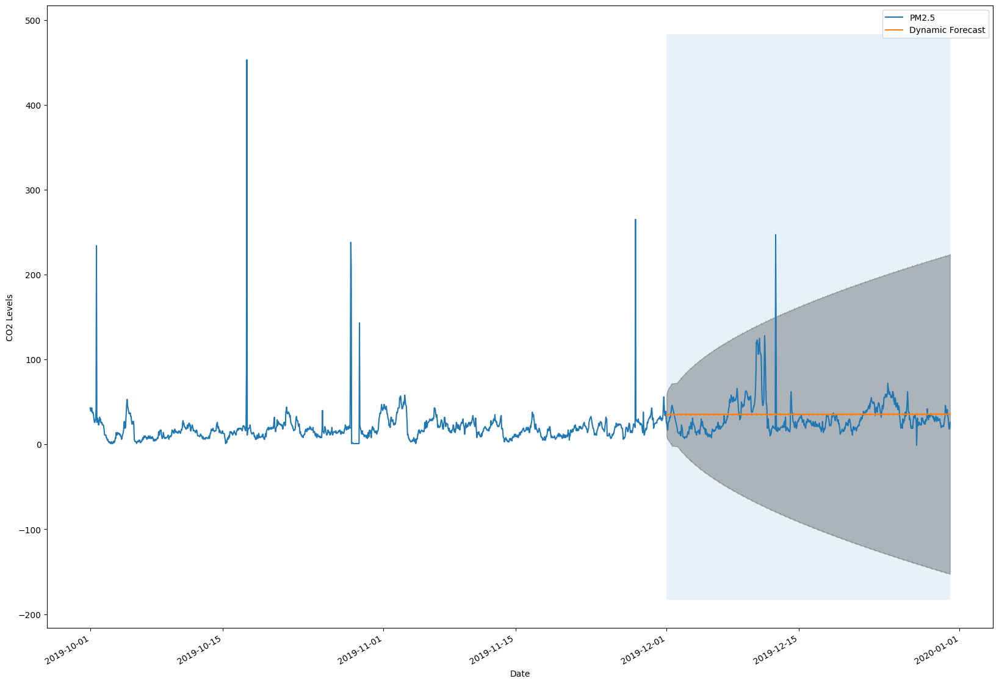

In [ ]:
ax =  df_25_train['2019-10':].plot(label='observed', figsize=(20, 15))
pred_dynamic.predicted_mean.plot(label='Dynamic Forecast', ax=ax)

ax.fill_between(pred_dynamic_ci.index,
                pred_dynamic_ci.iloc[:, 0],
                pred_dynamic_ci.iloc[:, 1], color='k', alpha=.25)

ax.fill_betweenx(ax.get_ylim(), pd.to_datetime('2019-12-01'), df_25_train.index[-1],
                 alpha=.1, zorder=-1)

ax.set_xlabel('Date')
ax.set_ylabel('CO2 Levels')

plt.legend()
plt.show()

In [ ]:
y_forecasted = pred_dynamic.predicted_mean
y_forecasted = pd.DataFrame(y_forecasted,columns={"PM2.5"})
mte_truth = df_25_train['2019-12-1':]

# Compute the mean square error
mse = ((y_forecasted - y_truth) ** 2).mean()
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))

ValueError: ignored

In [ ]:
pred_uc = results.get_forecast(steps=500)

# Get confidence intervals of forecasts
pred_ci = pred_uc.conf_int()